'''
link dataset
https://www.kaggle.com/datasets/vipoooool/new-plant-diseases-dataset
'''

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import pathlib
import os
import glob as gb
import glob
import cv2
import tensorflow as tf

In [2]:
train_dir='/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'
valid_dir='/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'
test_dir='/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid'

In [3]:
size=224
from tensorflow.keras.applications.mobilenet_v2 import  preprocess_input

train_generator=tf.keras.preprocessing.image.ImageDataGenerator(
    
    rescale=1/255.0,
    preprocessing_function=None,
    validation_split=0.1
    
).flow_from_directory(train_dir,
                      batch_size=128,
                      target_size=(size,size),
                      subset="training",
                      
                      color_mode='rgb', #"rgb", "rgba", or "grayscale"
                      class_mode='categorical',  # Use 'binary', 'sparse','categorical' or None as needed
                      shuffle=True)

Found 63282 images belonging to 38 classes.


In [4]:
train_generator.class_indices

{'Apple___Apple_scab': 0,
 'Apple___Black_rot': 1,
 'Apple___Cedar_apple_rust': 2,
 'Apple___healthy': 3,
 'Blueberry___healthy': 4,
 'Cherry_(including_sour)___Powdery_mildew': 5,
 'Cherry_(including_sour)___healthy': 6,
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot': 7,
 'Corn_(maize)___Common_rust_': 8,
 'Corn_(maize)___Northern_Leaf_Blight': 9,
 'Corn_(maize)___healthy': 10,
 'Grape___Black_rot': 11,
 'Grape___Esca_(Black_Measles)': 12,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 13,
 'Grape___healthy': 14,
 'Orange___Haunglongbing_(Citrus_greening)': 15,
 'Peach___Bacterial_spot': 16,
 'Peach___healthy': 17,
 'Pepper,_bell___Bacterial_spot': 18,
 'Pepper,_bell___healthy': 19,
 'Potato___Early_blight': 20,
 'Potato___Late_blight': 21,
 'Potato___healthy': 22,
 'Raspberry___healthy': 23,
 'Soybean___healthy': 24,
 'Squash___Powdery_mildew': 25,
 'Strawberry___Leaf_scorch': 26,
 'Strawberry___healthy': 27,
 'Tomato___Bacterial_spot': 28,
 'Tomato___Early_blight': 29,
 'Toma

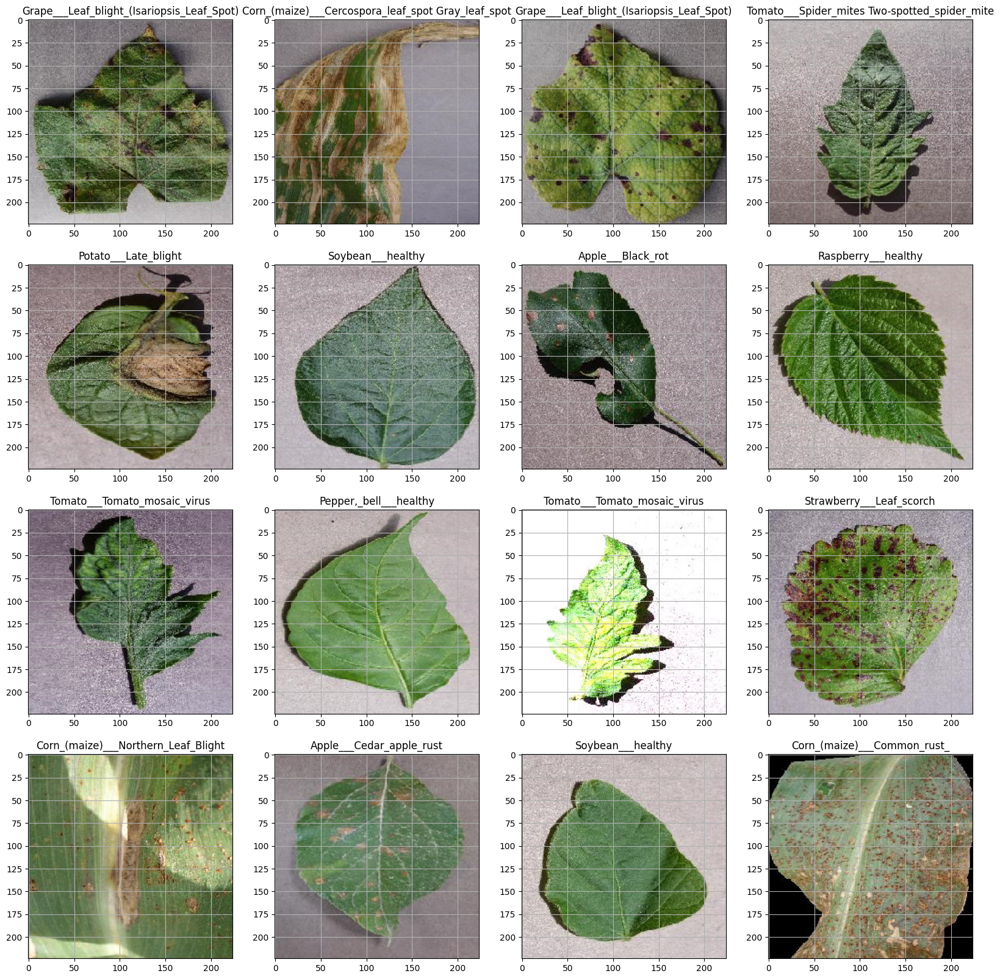

In [5]:
classes=list(train_generator.class_indices.keys())
plt.figure(figsize=(20,20))
for X_batch, y_batch in train_generator:
    # create a grid of 3x3 images
    for i in range(0,16):
        plt.subplot(4,4,i+1)
        plt.imshow(X_batch[i])
        plt.title(classes[np.where(y_batch[i]==1)[0][0]])   
        
        plt.grid(None)
   
    plt.show()
    break

In [6]:
valid_generator=tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1/255.0,
    preprocessing_function=None,
     validation_split=0.1
   
).flow_from_directory(train_dir,
                      batch_size=128,
                      target_size=(size,size),
                      subset='validation',
                      
                      color_mode='rgb', 
                      class_mode='categorical', 
                      shuffle=False)

Found 7013 images belonging to 38 classes.


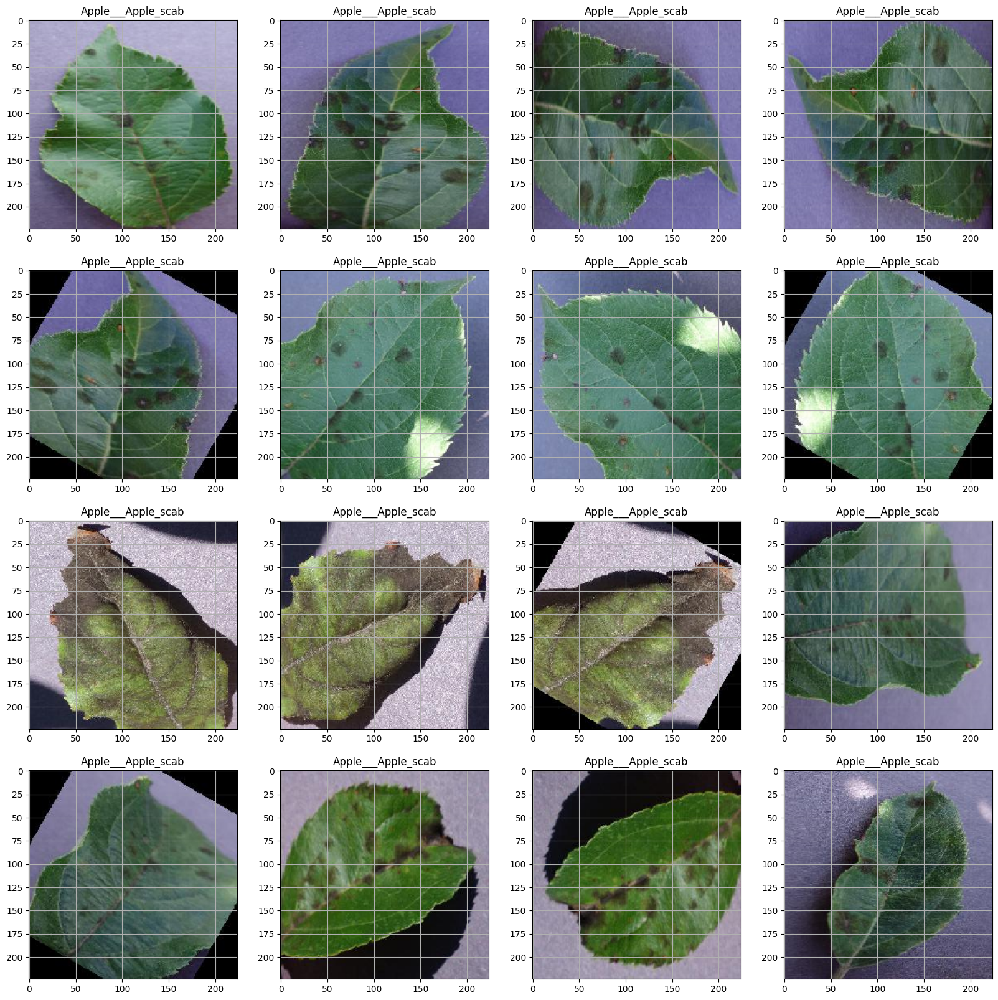

In [7]:
classes=list(valid_generator.class_indices.keys())
plt.figure(figsize=(20,20))
for X_batch, y_batch in valid_generator:
   
    for i in range(0,16):
        plt.subplot(4,4,i+1)
        plt.imshow(X_batch[i])
        plt.title(classes[np.where(y_batch[i]==1)[0][0]])  
        
        plt.grid(None)
    
    plt.show()
    break


In [8]:
test_data=tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1/255.0,
    preprocessing_function=None
).flow_from_directory(test_dir,
                      batch_size=128,
                      target_size=(224,224),
                      color_mode='rgb',
                      class_mode='categorical',  
                      shuffle=False)

Found 17572 images belonging to 38 classes.


In [9]:
test_data.class_indices


{'Apple___Apple_scab': 0,
 'Apple___Black_rot': 1,
 'Apple___Cedar_apple_rust': 2,
 'Apple___healthy': 3,
 'Blueberry___healthy': 4,
 'Cherry_(including_sour)___Powdery_mildew': 5,
 'Cherry_(including_sour)___healthy': 6,
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot': 7,
 'Corn_(maize)___Common_rust_': 8,
 'Corn_(maize)___Northern_Leaf_Blight': 9,
 'Corn_(maize)___healthy': 10,
 'Grape___Black_rot': 11,
 'Grape___Esca_(Black_Measles)': 12,
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)': 13,
 'Grape___healthy': 14,
 'Orange___Haunglongbing_(Citrus_greening)': 15,
 'Peach___Bacterial_spot': 16,
 'Peach___healthy': 17,
 'Pepper,_bell___Bacterial_spot': 18,
 'Pepper,_bell___healthy': 19,
 'Potato___Early_blight': 20,
 'Potato___Late_blight': 21,
 'Potato___healthy': 22,
 'Raspberry___healthy': 23,
 'Soybean___healthy': 24,
 'Squash___Powdery_mildew': 25,
 'Strawberry___Leaf_scorch': 26,
 'Strawberry___healthy': 27,
 'Tomato___Bacterial_spot': 28,
 'Tomato___Early_blight': 29,
 'Toma

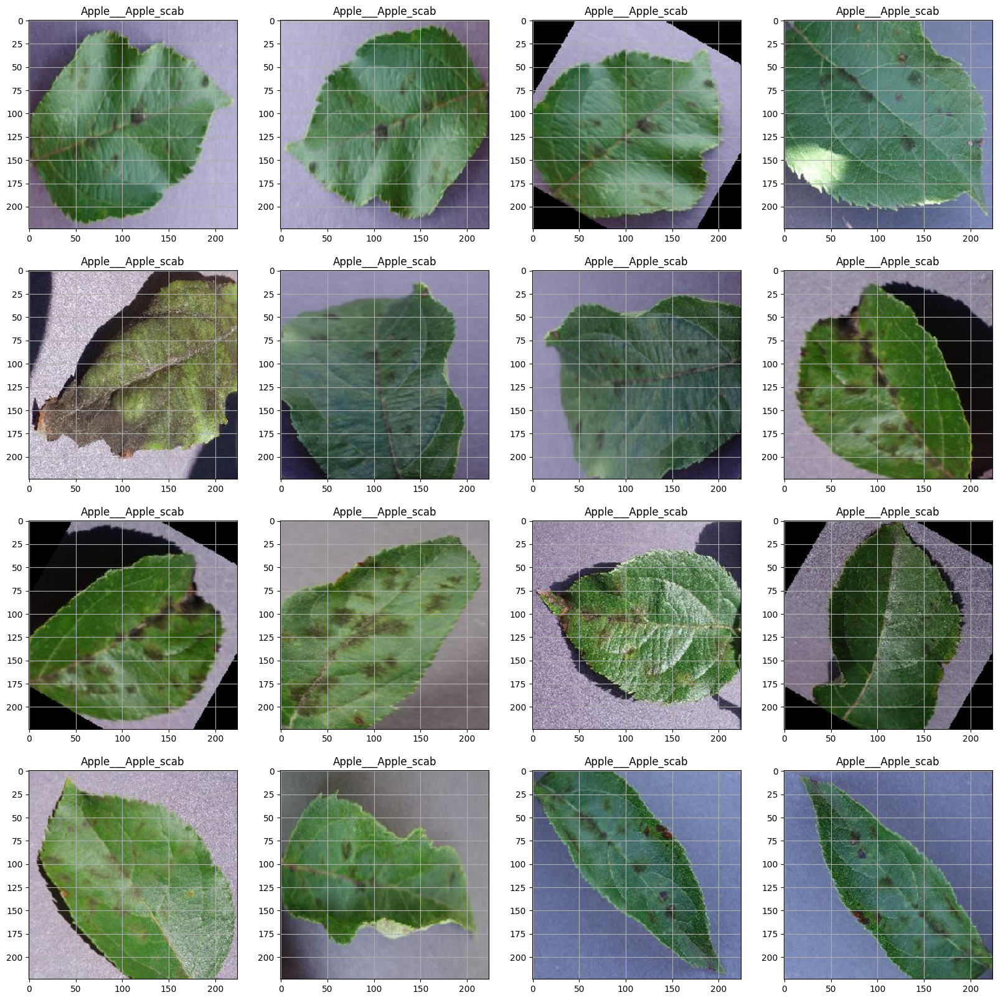

In [10]:
classes=list(test_data.class_indices.keys())
plt.figure(figsize=(20,20))
for X_batch, y_batch in test_data:
    # create a grid of 3x3 images
    for i in range(0,16):
        plt.subplot(4,4,i+1)
        plt.imshow(X_batch[i])
        plt.title(classes[np.where(y_batch[i]==1)[0][0]])   # when y is categorical
        # plt.title(classes[int(y_batch[i])])   # when y is binary or sparse 
        plt.grid(None)
    # show the plot
    plt.show()
    break

In [11]:
models = { 
"Xception": tf.keras.applications.Xception,

"VGG16": tf.keras.applications.VGG16,

"VGG19": tf.keras.applications.VGG19,

"ResNet50": tf.keras.applications.ResNet50,

"ResNet101": tf.keras.applications.ResNet101,

"ResNet152": tf.keras.applications.ResNet152,

"InceptionV3": tf.keras.applications.InceptionV3,

"MobileNet": tf.keras.applications.MobileNet,

"MobileNetV2": tf.keras.applications.MobileNetV2,
"DenseNet121": tf.keras.applications.DenseNet121,
    "DenseNet169": tf.keras.applications.DenseNet169,

"DenseNet201": tf.keras.applications.DenseNet201,

"NASNetMobile": tf.keras.applications.NASNetMobile,

"NASNetLarge": tf.keras.applications.NASNetLarge,

"EfficientNetB0": tf.keras.applications.EfficientNetB0,

"EfficientNetB1": tf.keras.applications.EfficientNetB1,

"EfficientNetB2": tf.keras.applications.EfficientNetB2,

"EfficientNetB3": tf.keras.applications.EfficientNetB3,

"EfficientNetB4": tf.keras.applications.EfficientNetB4,

"EfficientNetB5": tf.keras.applications.EfficientNetB5,
"EfficientNetB6": tf.keras.applications.EfficientNetB6,
"EfficientNetB7": tf.keras.applications.EfficientNetB7
}

In [12]:
# Define input shape
input_shape = (224, 224, 3)  # Adjust height, width, and channels as needed


# Define inputs
inputs = tf.keras.Input(shape=input_shape)
print(inputs )
model_name='MobileNetV2'
# Load the base model
base_model = models[model_name](include_top=False, weights='imagenet', input_tensor=inputs)
# Freeze the base model layers
base_model.trainable = False

x = tf.keras.layers.Flatten()(base_model.output)
x = tf.keras.layers.GlobalAveragePooling2D()(base_model.output)
x = tf.keras.layers.Dense(256, activation='relu')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dropout(0.3)(x)
x = tf.keras.layers.Dense(64, activation='relu')(x)
x = tf.keras.layers.BatchNormalization()(x)
x = tf.keras.layers.Dropout(0.3)(x)
outputs = tf.keras.layers.Dense(38, activation='softmax')(x)
# Create model
model = tf.keras.models.Model(inputs = inputs, outputs = outputs)

# Compiling the model
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999)

model.compile(loss="categorical_crossentropy", optimizer= optimizer, metrics=["accuracy",'precision','recall'])

# Display summary
model.summary()

<KerasTensor shape=(None, 224, 224, 3), dtype=float32, sparse=None, name=keras_tensor>


/tmp/ipykernel_30/405595624.py:10: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = models[model_name](include_top=False, weights='imagenet', input_tensor=inputs)


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,606,118 (9.94 MB)

 Trainable params: 347,494 (1.33 MB)

 Non-trainable params: 2,258,624 (8.62 MB)

In [13]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint,ReduceLROnPlateau

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model_checkpoint = ModelCheckpoint('best_model.keras', monitor='val_loss', save_best_only=True)

model_ReduceLROnPlateau = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=0.000001)

callbacks=[early_stopping,model_checkpoint,model_ReduceLROnPlateau]

In [14]:
history = model.fit(train_generator,
                    epochs = 50,
                    batch_size=None,
                    validation_data = valid_generator,
                    callbacks = callbacks
                    )

Epoch 1/50


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1733593005.545743     116 service.cc:145] XLA service 0x7bf2c4013400 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1733593005.545803     116 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0


  2/495 ━━━━━━━━━━━━━━━━━━━━ 42s 85ms/step - accuracy: 0.0137 - loss: 4.5283 - precision: 0.0000e+00 - recall: 0.0000e+00   

I0000 00:00:1733593016.767755     116 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


495/495 ━━━━━━━━━━━━━━━━━━━━ 569s 1s/step - accuracy: 0.6671 - loss: 1.3248 - precision: 0.9097 - recall: 0.4697 - val_accuracy: 0.9152 - val_loss: 0.2653 - val_precision: 0.9426 - val_recall: 0.8878 - learning_rate: 0.0010
Epoch 2/50
495/495 ━━━━━━━━━━━━━━━━━━━━ 183s 365ms/step - accuracy: 0.9096 - loss: 0.3048 - precision: 0.9425 - recall: 0.8757 - val_accuracy: 0.9318 - val_loss: 0.2085 - val_precision: 0.9486 - val_recall: 0.9182 - learning_rate: 0.0010
Epoch 3/50
495/495 ━━━━━━━━━━━━━━━━━━━━ 181s 362ms/step - accuracy: 0.9301 - loss: 0.2223 - precision: 0.9506 - recall: 0.9108 - val_accuracy: 0.9343 - val_loss: 0.1956 - val_precision: 0.9465 - val_recall: 0.9240 - learning_rate: 0.0010
Epoch 4/50
495/495 ━━━━━━━━━━━━━━━━━━━━ 180s 359ms/step - accuracy: 0.9401 - loss: 0.1880 - precision: 0.9561 - recall: 0.9255 - val_accuracy: 0.9454 - val_loss: 0.1612 - val_precision: 0.9556 - val_recall: 0.9387 - learning_rate: 0.0010
Epoch 5/50
495/495 ━━━━━━━━━━━━━━━━━━━━ 181s 362ms/step - accu

In [15]:
#plotting training values
import seaborn as sns
sns.set()

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

precision = history.history['precision']
val_precision = history.history['val_precision']

recall =history.history['recall']
val_recall =history.history['val_recall']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(1, len(loss) + 1)

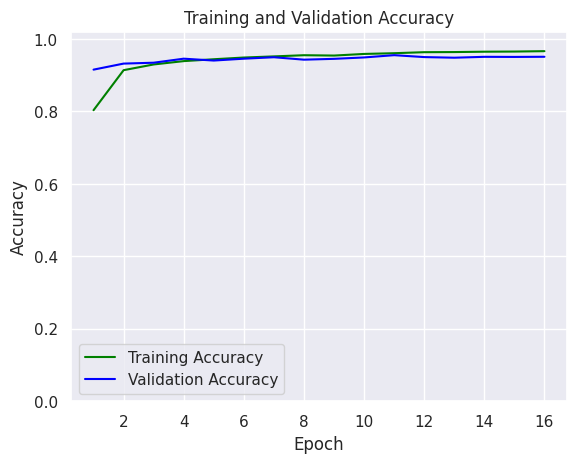

In [16]:
#accuracy plot
plt.plot(epochs, acc, color='green', label='Training Accuracy')
plt.plot(epochs, val_acc, color='blue', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.ylim(0,1.02)
plt.show()

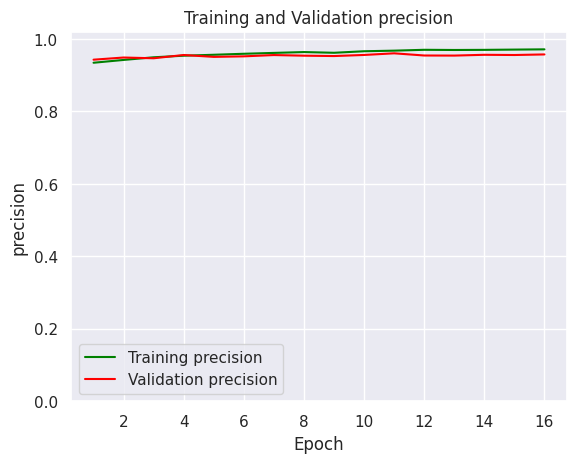

In [17]:
plt.figure()
#loss plot
plt.plot(epochs, precision, color='green', label='Training precision')
plt.plot(epochs, val_precision, color='red', label='Validation precision')
plt.title('Training and Validation precision')
plt.xlabel('Epoch')
plt.ylabel('precision')
plt.legend()
plt.ylim(0,1.02)
plt.show()

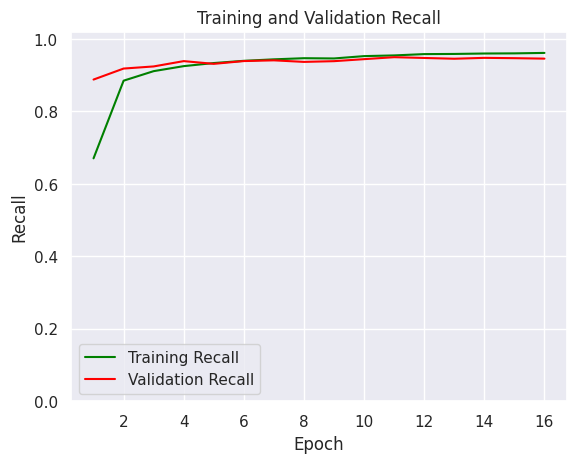

In [18]:
plt.figure()
#loss plot
plt.plot(epochs, recall, color='green', label='Training Recall')
plt.plot(epochs, val_recall, color='red', label='Validation Recall')
plt.title('Training and Validation Recall')
plt.xlabel('Epoch')
plt.ylabel('Recall')
plt.legend()
plt.ylim(0,1.02)
plt.show()

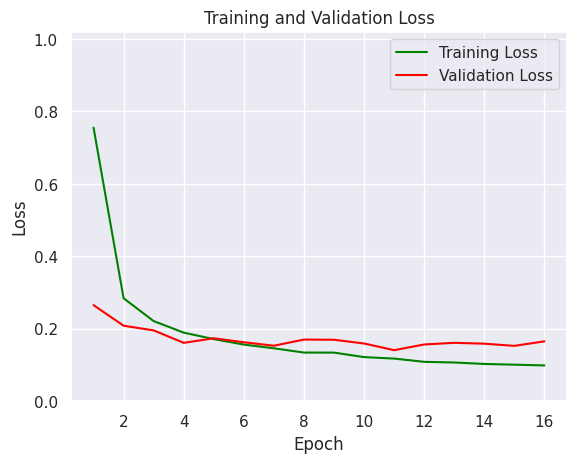

In [19]:
plt.figure()
#loss plot
plt.plot(epochs, loss, color='green', label='Training Loss')
plt.plot(epochs, val_loss, color='red', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.ylim(0,1.02)
plt.show()

In [20]:
def Evaluate_model(model, train_generator, valid_generator, test_data):
    
    # Evaluate the model on training data
    model_evaluate_train = model.evaluate(train_generator)
    print('Training loss:', model_evaluate_train[0])
    print('Training Accuracy:', model_evaluate_train[1])
    print('Training Precision:', model_evaluate_train[2])
    print('Training Recall:', model_evaluate_train[3])

    # Evaluate the model on validation data
    model_evaluate_valid = model.evaluate(valid_generator)
    print('Validation loss:', model_evaluate_valid[0])
    print('Validation Accuracy:', model_evaluate_valid[1])
    print('Validation Precision:', model_evaluate_valid[2])
    print('Validation Recall:', model_evaluate_valid[3])
    # Evaluate the model on test data
    model_evaluate_test = model.evaluate(test_data)
    print('Test loss:', model_evaluate_test[0])
    print('Test Accuracy:', model_evaluate_test[1])
    print('Test Precision:', model_evaluate_test[2])
    print('Test Recall:', model_evaluate_test[3])
    # Return rounded metrics
    return (np.round(model_evaluate_train[0], 2), np.round(model_evaluate_test[0], 2),
            np.round(model_evaluate_train[1], 2), np.round(model_evaluate_test[1], 2),
            np.round(model_evaluate_train[2], 2), np.round(model_evaluate_test[2], 2),
            np.round(model_evaluate_train[3], 2), np.round(model_evaluate_test[3], 2))

In [21]:
final_report = []


In [22]:
final_report.append(Evaluate_model(model, train_generator, valid_generator, test_data))

495/495 ━━━━━━━━━━━━━━━━━━━━ 161s 325ms/step - accuracy: 0.9878 - loss: 0.0400 - precision: 0.9898 - recall: 0.9855
Training loss: 0.040192876011133194
Training Accuracy: 0.9875320196151733
Training Precision: 0.9898558259010315
Training Recall: 0.9853196740150452
55/55 ━━━━━━━━━━━━━━━━━━━━ 18s 320ms/step - accuracy: 0.9752 - loss: 0.0919 - precision: 0.9770 - recall: 0.9709
Validation loss: 0.1409827470779419
Validation Accuracy: 0.955083429813385
Validation Precision: 0.9602018594741821
Validation Recall: 0.9495223164558411


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


138/138 ━━━━━━━━━━━━━━━━━━━━ 157s 1s/step - accuracy: 0.9759 - loss: 0.0814 - precision: 0.9777 - recall: 0.9741
Test loss: 0.11502904444932938
Test Accuracy: 0.9624971747398376
Test Precision: 0.9678993821144104
Test Recall: 0.9591964483261108


In [23]:
class_names=['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus', 'Tomato___healthy']

class_names

['Apple___Apple_scab',
 'Apple___Black_rot',
 'Apple___Cedar_apple_rust',
 'Apple___healthy',
 'Blueberry___healthy',
 'Cherry_(including_sour)___Powdery_mildew',
 'Cherry_(including_sour)___healthy',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Corn_(maize)___Common_rust_',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Corn_(maize)___healthy',
 'Grape___Black_rot',
 'Grape___Esca_(Black_Measles)',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Grape___healthy',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Peach___Bacterial_spot',
 'Peach___healthy',
 'Pepper,_bell___Bacterial_spot',
 'Pepper,_bell___healthy',
 'Potato___Early_blight',
 'Potato___Late_blight',
 'Potato___healthy',
 'Raspberry___healthy',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Strawberry___Leaf_scorch',
 'Strawberry___healthy',
 'Tomato___Bacterial_spot',
 'Tomato___Early_blight',
 'Tomato___Late_blight',
 'Tomato___Leaf_Mold',
 'Tomato___Septoria_leaf_spot',
 'Tomato___Spider_mites Two-spotted_

In [24]:
def predict_image(model, test_dir_without_output, class_names):

    files = gb.glob(pathname= str(test_dir_without_output + '/*.JPG'))

# Create a figure with 11 rows and 3 columns

    fig, axes = plt.subplots (11, 3, figsize=(15, 55)) # Adjust figsize as needed for better visualization

# Flatten axes for easy indexing in the Loop

    axes = axes.ravel()
    for index, path in enumerate(files): 
        img = cv2.imread(path)
        H,W,C = 224,224,3 
        img = cv2.resize(img, (H, W))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = np.array(img).astype("float32") / 255.0


        axes[index].imshow(img)

        prediction = np.argmax(model.predict(img.reshape(1,H,W, C), verbose=0),axis=-1)[0]

        actual = path.split('/')[-1][:-4] 
        axes[index].set_title(f"Actual: {actual}\npredict: {class_names [prediction]}",) 
        axes[index].axis('off') # Optional: turn off axes

    plt.tight_layout()

    plt.show()

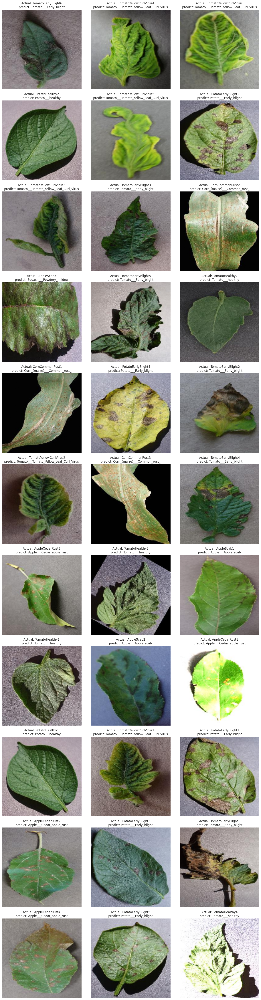

In [25]:
test_dir_without_output = '/kaggle/input/new-plant-diseases-dataset/test/test/'
predict_image(model, test_dir_without_output, class_names)

In [26]:
model_namee=['MobileNetV2']
final_report = final_report[:1]

model_accuracy=pd.DataFrame(final_report,index=model_namee,columns=['Train Loss','Test Loss','Train Accuracy','Test Accuracy'
                                                                  ,'Train Precision','Test Precision','Train Recall','Test Recall'])
model_accuracy.head()


,Train Loss,Test Loss,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall
MobileNetV2,0.04,0.12,0.99,0.96,0.99,0.97,0.99,0.96


In [27]:
model_accuracy.to_csv('final.csv', index=False)

In [28]:
# Save the entire model (architecture + weights + optimizer state)
model.save('model_name.h5')  # Save as HDF5 format
# Save only the weights
model.save_weights('weights.weights.h5')

